# Capstone 2: Data Wrangling

This notebook encompasses the data wrangling portion of my second capstone project. The problem I am trying to solve for is how can I use the UCI Heart Disease Dataset (https://www.kaggle.com/datasets/redwankarimsony/heart-disease-data?resource=download) to predict someone's risk of developing heart disease?

In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport

In [2]:
# Read UCI Heart Disease Dataset into pandas dataframe
hd_data = pd.read_csv('../data/raw/heart_disease_uci.csv')

In [3]:
# View sample of heart disease dataset
pd.set_option('display.max_columns', None)
hd_data.head()

,id,age,sex,dataset,cp,trestbps,chol,fbs,restecg,thalch,exang,oldpeak,slope,ca,thal,num
0,1,63,Male,Cleveland,typical angina,145.0,233.0,True,lv hypertrophy,150.0,False,2.3,downsloping,0.0,fixed defect,0
1,2,67,Male,Cleveland,asymptomatic,160.0,286.0,False,lv hypertrophy,108.0,True,1.5,flat,3.0,normal,2
2,3,67,Male,Cleveland,asymptomatic,120.0,229.0,False,lv hypertrophy,129.0,True,2.6,flat,2.0,reversable defect,1
3,4,37,Male,Cleveland,non-anginal,130.0,250.0,False,normal,187.0,False,3.5,downsloping,0.0,normal,0
4,5,41,Female,Cleveland,atypical angina,130.0,204.0,False,lv hypertrophy,172.0,False,1.4,upsloping,0.0,normal,0


The UCI Heart Disease Dataset is composed of 16 columns. These 16 columns consist of a unique identifier, a dataset identifier, 13 predictive features, and 1 target feature.

Unique Identifier:

1. **id** Unique id for each patient

Dataset Identifier:

2. **dataset** Place of study

Predictive Features: 

3. **age** Age of the patient in years
4. **sex** Sex of the patient (Male/Female)
5. **cp** Chest pain type (typical angina, atypical angina, non-anginal, asymptomatic)
6. **trestbps** Resting blood pressure (in mm Hg) on admission to the hospital
7. **chol** Serum cholesterol (in mg/dl)
8. **fbs** If fasting blood sugar > 120 mg/dl (True / False)
9. **restecg** Resting electrocardiographic results (normal, stt abnormality, lv hypertrophy)
10. **thalch** Maximum heart rate achieved
11. **exang** Exercise-induced angina (True/ False)
12. **oldpeak** ST depression induced by exercise relative to rest
13. **slope** Slope of the peak exercise ST segment (flat, upsloping, downsloping)
14. **ca** Number of major vessels (0-3) colored by fluoroscopy
15. **thal** (Normal; fixed defect; reversible defect)

Target Feature:

16. **num** Stage of heart disease (0, 1, 2, 3, 4)

To get an idea of what the data looks like, first we generate a profile report of the entire dataset using ydata-profiling

In [4]:
profile = ProfileReport(hd_data, title="Heart Disease Profiling Report")
profile.to_notebook_iframe()
profile.to_file("../reports/Heart Disease Profiling Report (raw data).html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

The profile report highlights a few things with our data. First, we are missing 12% of the values in our dataset (none of which are the target feature), and three of the columns are missing at least a third of their values (slope, ca, and thal). chol (serum cholesterol) has 0 for almost 20% of its values (which doesn't make sense) so this column is also missing about a fifth of its values. trestbps (resting blood pressure) also has a 0 value that doesn't make sense, so we'll treat this as a missing value, as well. Although, 40% of oldpeak's values are 0, this could mean that there was no ST depression induced by exercise, so we'll leave those for now. The negative numbers don't really make sense, however, so we'll treat those as missing.

In [5]:
hd_data['chol'] = hd_data['chol'].replace(0, np.nan)
hd_data['trestbps'] = hd_data['trestbps'].replace(0, np.nan)
hd_data.loc[hd_data['oldpeak'] < 0, 'oldpeak'] = np.nan

The profile report also revealed four different values in the dataset column. We'll want to investigate this further to see if some of the datasets are missing more values than others (or if there are any other major differences). To do this, we'll create profile reports by dataset.

In [6]:
for dataset in hd_data.dataset.unique():
    data = hd_data.loc[hd_data.dataset == dataset]
    profile = ProfileReport(data, title=f"Heart Disease Profiling Report: {dataset}")
    profile.to_notebook_iframe()
    profile.to_file(f"../reports/Heart Disease Profiling Data Wrangling Report - {dataset}.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Splitting the profile reports by dataset reveals a few things. First, we see that all of the datasets have a high number of zeros for the oldpeak variable, so it's likely these are actual zeros. It seems to be a lower boundary (no ST depression induced by exercise) and a common value. Next, we see that the "Cleveland" dataset is much more complete than any of the other datasets. It is only missing 0.2% of its values, and no column is missing more than five values (out of 304 observations). All of the other datasets are missing at least 16.6% of their values, and have at least two columns that are missing half or more of their values. Because of this, we are going to look at the Cleveland dataset on its own (to see if the additional data helps with our predictions) and create a second dataset that uses all locations.

In [7]:
cleveland_hd_data = hd_data.loc[hd_data.dataset=='Cleveland']
all_hd_data = hd_data

The missing value heatmaps of the profile reports showed some really high correlations between missing values (e.g. thalch and exang and thalch and trestbps). Before we remove any predictive features or rows from the dataset, let's first try to understand what the distribution of missing values by observation looks like and what the number of missing values by features are.

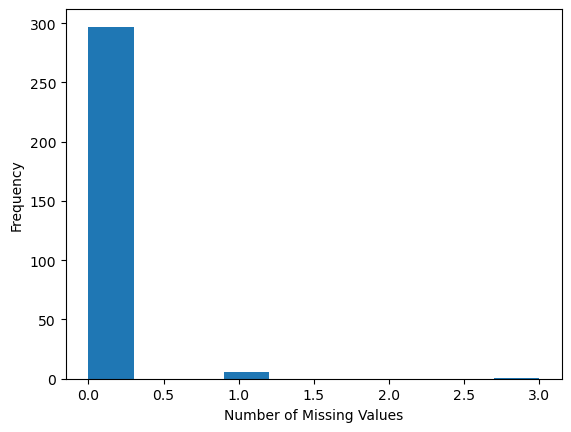

   Number of Observations        Pct
0                     297  97.697368
1                       6   1.973684
3                       1   0.328947


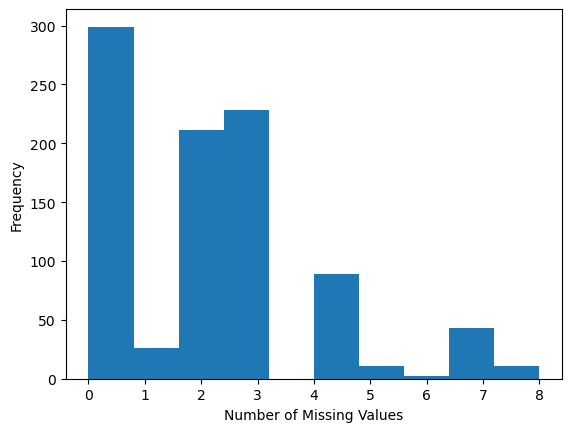

   Number of Observations        Pct
0                     299  32.500000
1                      26   2.826087
2                     211  22.934783
3                     228  24.782609
4                      89   9.673913
5                      11   1.195652
6                       2   0.217391
7                      43   4.673913
8                      11   1.195652


In [8]:
%matplotlib inline
def plot_missing_values_by_row(data):
    missing_values_by_row = data.isnull().sum(axis=1)
    plt.hist(missing_values_by_row)
    plt.xlabel('Number of Missing Values')
    plt.ylabel('Frequency')
    plt.show()
    missing_values_by_count = pd.DataFrame({
        'Number of Observations': missing_values_by_row.value_counts()
    })
    missing_values_by_count['Pct'] = (missing_values_by_count['Number of Observations'] / len(data)) * 100
    print(missing_values_by_count.sort_index())
plot_missing_values_by_row(cleveland_hd_data)
plot_missing_values_by_row(all_hd_data)

Right away we see that only about 2% of the observations in the Cleveland dataset are missing any data. Later, we can impute these values. For now, we'll leave the dataset as is.

Over 60% of the observations in the non-Cleveland dataset are missing 2 or more features, however, so let's take a closer look at which columns have the most missing values in this dataset.

In [9]:
missing = pd.concat([all_hd_data.isnull().sum(), 100 * all_hd_data.isnull().mean()], axis=1)
missing.columns=['count', '%']
missing.sort_values(by='count', ascending=False)

,count,%
ca,611,66.413043
thal,486,52.826087
slope,309,33.586957
chol,202,21.956522
fbs,90,9.782609
oldpeak,74,8.043478
trestbps,60,6.521739
thalch,55,5.978261
exang,55,5.978261
restecg,2,0.217391


Four variables (ca, thal, slope, and chol) are missing at least a third of their values. That is a lot of data to impute and could introduce bias into our models especially since some of these percentages are driven by large missing percentages in one of the datasets. There could be differences between the datasets that would make our imputations inaccurate, so we are going to drop those three columns from the non-Cleveland dataset and see if we can predict the likelihood of heart disease with fewer variables. We still have our Cleveland dataset that is more complete that we can use to build a more robust model. Next, we plot the distribution of missing values by observation again to see how many rows are still missing values.

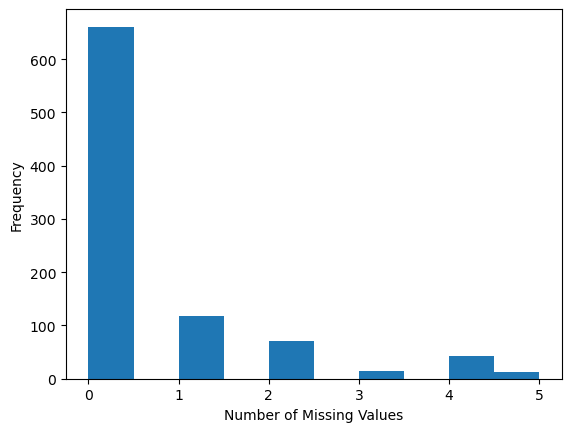

   Number of Observations        Pct
0                     661  71.847826
1                     118  12.826087
2                      71   7.717391
3                      15   1.630435
4                      42   4.565217
5                      13   1.413043


In [10]:
all_hd_data = all_hd_data.drop(columns=['ca', 'thal', 'slope'])
plot_missing_values_by_row(all_hd_data)

That's a lot better, but about 15% of our data is still missing at least two features and almost 40% of those are missing 4 or more features. Since we'd have to impute almost half of the data for these rows, we're going to drop them.

In [11]:
rows_to_drop = all_hd_data.isnull().sum(axis=1) >= 4
all_hd_data = all_hd_data.drop(all_hd_data.index[rows_to_drop])

Let's look again at the number of missing values by variable to see which variables are still missing values.

In [12]:
missing = pd.concat([all_hd_data.isnull().sum(), 100 * all_hd_data.isnull().mean()], axis=1)
missing.columns=['count', '%']
missing.sort_values(by='count', ascending=False)

,count,%
chol,188,21.734104
fbs,89,10.289017
oldpeak,19,2.196532
trestbps,5,0.578035
restecg,2,0.231214
thalch,1,0.115607
exang,1,0.115607
id,0,0.000000
age,0,0.000000
sex,0,0.000000


A large majority of the missing values are for the chol variable (which is missing in about 22% of observations). fbs is also missing in about 10% of observations. Later on we can impute the missing data, but we'll leave the dataset as is for now.

The profile reports showed that the target feature (num) had more than just values of 0 and 1, though. In some of the datasets (Cleveland, Switzerland, and VA Long Beach), the values in this column corresponded to stages of heart disease. In the Hungary dataset, we are unsure of whether a value of 1 means "Has Heart Disease" or means "Stage 1 Heart Disease". Since we are trying to determine the risk of heart disease, not the stage, we are going to treat the target feature as "Has Heart Disease" (1) and "Does Not Have Heart Disease" (0). Another reason to do this is that we only have a few observations for some of the different stages of heart disease. Trying to model such a small sample size might lead to poor results.

In [13]:
all_hd_data.loc[all_hd_data['num'] > 0, 'num'] = 1
cleveland_hd_data.loc[cleveland_hd_data['num'] > 0, 'num'] = 1

Here are the final profile reports:

In [14]:
profile = ProfileReport(all_hd_data, title="All Datasets: Heart Disease Profiling Report")
profile.to_notebook_iframe()
profile.to_file(f"../reports/Heart Disease Profiling Final Data Wrangling Report - All (Short).html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
profile = ProfileReport(cleveland_hd_data, title="Cleveland Dataset: Heart Disease Profiling Report")
profile.to_notebook_iframe()
profile.to_file(f"../reports/Heart Disease Profiling Final Data Wrangling Report - Cleveland (Full).html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Finally, we save our datasets for further analysis and modeling.

In [16]:
all_hd_data.to_csv('..\data\interim\heart_disease_data_all.csv')
cleveland_hd_data.to_csv('..\data\interim\heart_disease_data_cleveland.csv')